In [2]:
import numpy as np
import pandas as pd

import plotly.express as px
import plotly.io as pio

from sklearn.neighbors import NearestNeighbors
from matplotlib import pyplot as plt

from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score

from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

In [3]:
df = pd.read_csv("uber-trip-data/uber-raw-data-apr14.csv")
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [4]:
df['Day_name'] = pd.to_datetime(df['Date/Time']).dt.day_name()

df.drop(["Date/Time"], axis = 1, inplace=True)

df.head(5)

,Lat,Lon,Base,Day_name
0,40.7690,-73.9549,B02512,Tuesday
1,40.7267,-74.0345,B02512,Tuesday
2,40.7316,-73.9873,B02512,Tuesday
3,40.7588,-73.9776,B02512,Tuesday
4,40.7594,-73.9722,B02512,Tuesday


Base : TLC (Taxi and Limousine Commission) code
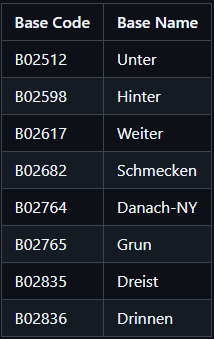

In [5]:
df.shape

(564516, 4)

In [6]:
df.head()

,Lat,Lon,Base,Day_name
0,40.7690,-73.9549,B02512,Tuesday
1,40.7267,-74.0345,B02512,Tuesday
2,40.7316,-73.9873,B02512,Tuesday
3,40.7588,-73.9776,B02512,Tuesday
4,40.7594,-73.9722,B02512,Tuesday


# Preprocessing


In [7]:
df.shape

(564516, 4)

In [8]:
numeric_features = ["Lat", "Lon"]

numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first'))
    ])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
    ])

# Reprendre KMEANS avec toutes les valeurs d'avril 2014 sur les clusters trouvés avant

In [9]:
def get_hot_zone_by_day(df_april, day_name):
  mask = df_april["Day_name"] == day_name
  df_copy = df_april[mask]

  df_copy = df_copy[["Lat", "Lon"]]

  df_copy.reset_index(drop=True, inplace=True)

  return df_copy

In [10]:
def get_kmeans_by_day(df_copy, day_name):
  print(f"Preprocessing {day_name}...")
  X = preprocessor.fit_transform(df_copy)
  print(f"... {day_name} Terminé.")

  km = KMeans(n_clusters = 4)
  km.fit(X)

  df_copy["Cluster_KMeans"] = pd.Series(km.labels_)

  fig = px.scatter_map(df_copy, lat="Lat", lon="Lon", color="Cluster_KMeans", zoom=8, width=800, title=day_name)
  fig.show()

In [11]:
df_april = df[["Lat", "Lon", "Day_name"]]

In [12]:
for day_name in df_april['Day_name'].unique():
  df_copy_day = get_hot_zone_by_day(df_april, day_name)
  display(df_copy_day.shape)
  get_kmeans_by_day(df_copy_day, day_name)

(91185, 2)

Preprocessing Tuesday...
... Tuesday Terminé.


(108631, 2)

Preprocessing Wednesday...
... Wednesday Terminé.


(85067, 2)

Preprocessing Thursday...
... Thursday Terminé.


(90303, 2)

Preprocessing Friday...
... Friday Terminé.


(77218, 2)

Preprocessing Saturday...
... Saturday Terminé.


(51251, 2)

Preprocessing Sunday...
... Sunday Terminé.


(60861, 2)

Preprocessing Monday...
... Monday Terminé.


In [17]:
print("Preprocessing April...")
X = preprocessor.fit_transform(df_april)
print("...Terminé.")

km = KMeans(n_clusters = 4)
km.fit(X)

df_april["Cluster_KMeans"] = pd.Series(km.labels_)

fig = px.scatter_map(df_april, lat="Lat", lon="Lon", color="Cluster_KMeans", zoom=8, width=800, title=day_name, animation_frame="Day_name")
fig.show()

pio.write_html(fig, file='sample_april_KMEANS.html', auto_play=True)

Preprocessing April...
...Terminé.
